# Import Required Libraries
Import the necessary libraries, including GeoPandas, Shapely, and Pandas.

In [86]:
import geopandas as gpd
from shapely.geometry import Point
import pandas as pd
import numpy as np
import geopandas as gpd
from pathlib import Path

from PIL import Image
import matplotlib.pyplot as plt

data_path = Path('London_UK')

# Load data
panoids = gpd.read_file(data_path / 'panoids/panoids.geojson')
network = gpd.read_file(data_path / 'network/edges/edges.geojson')

# Load Street Network Data
Load the street network data from a GeoJSON file or other data source.

In [87]:
# Load Street Network Data
streets = network  # Replace with your data source

# Load Image GPS Coordinates
Create a DataFrame with image IDs and their corresponding GPS coordinates.

In [88]:
# Load Image GPS Coordinates
# Create a DataFrame with image IDs and their corresponding GPS coordinates

image_data = {
    'image_id': np.linspace(0, len(panoids) - 1, len(panoids)),
    'longitude': panoids.lng,
    'latitude': panoids.lat,
}
images_df = pd.DataFrame(image_data)

# Create GeoDataFrame for images
geometry = [Point(xy) for xy in zip(images_df['longitude'], images_df['latitude'])]
images_gdf = gpd.GeoDataFrame(images_df, geometry=geometry, crs=streets.crs)

# Create GeoDataFrame for Images
Convert the DataFrame to a GeoDataFrame with Point geometries and set the coordinate reference system (CRS).

In [89]:
# Create GeoDataFrame for Images
geometry = [Point(xy) for xy in zip(images_df['longitude'], images_df['latitude'])]
images_gdf = gpd.GeoDataFrame(images_df, geometry=geometry, crs=streets.crs)

# Perform Spatial Join
Use the sjoin_nearest function to find the nearest street for each image and add the distance information.

In [90]:
# Perform Spatial Join
matched = gpd.sjoin_nearest(images_gdf, streets, how='left', distance_col='distance')

# Now 'matched' contains street information for each image
matched[['image_id', 'longitude', 'latitude', 'distance'][:5][0:2]]
matched_first_row = matched.iloc[[8]]

print(matched_first_row[['image_id', 'longitude', 'latitude', 'distance']])


c:\Users\yigit\anaconda3\anaconda goeie\envs\street\Lib\site-packages\geopandas\array.py:403: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_nearest' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  warnings.warn(


   image_id  longitude   latitude  distance
8       8.0  -0.111446  51.510339  0.000574


In [91]:
def get_image_id_by_coords(lat, lon):
    # Find the row in the matched DataFrame that matches the given coordinates
    row = matched[(matched['latitude'] == lat) & (matched['longitude'] == lon)]
    
    if not row.empty:
        return row['image_id'].values[0]
    else:
        return None

# Example usage
latitude = 51.51033857385067  # Replace with the desired latitude
longitude = -0.1114464626242011  # Replace with the desired longitude
image_id = get_image_id_by_coords(latitude, longitude)

if image_id is not None:
    print(f"Image ID for coordinates ({latitude}, {longitude}): {image_id}")
else:
    print(f"No image found for coordinates ({latitude}, {longitude})")

Image ID for coordinates (51.51033857385067, -0.1114464626242011): 8.0


# Display Matched Results
Print or visualize the matched results, including image IDs and distances to the nearest streets.

      image_id      distance
0          0.0  4.727227e-04
1          1.0  4.652413e-04
2          2.0  4.817731e-04
3          3.0  1.958920e-05
4          4.0  3.804349e-06
...        ...           ...
9008    9008.0  9.611725e-06
9009    9009.0  7.151419e-06
9010    9010.0  3.945103e-06
9011    9011.0  4.789095e-07
9012    9012.0  5.151160e-06

[9135 rows x 2 columns]


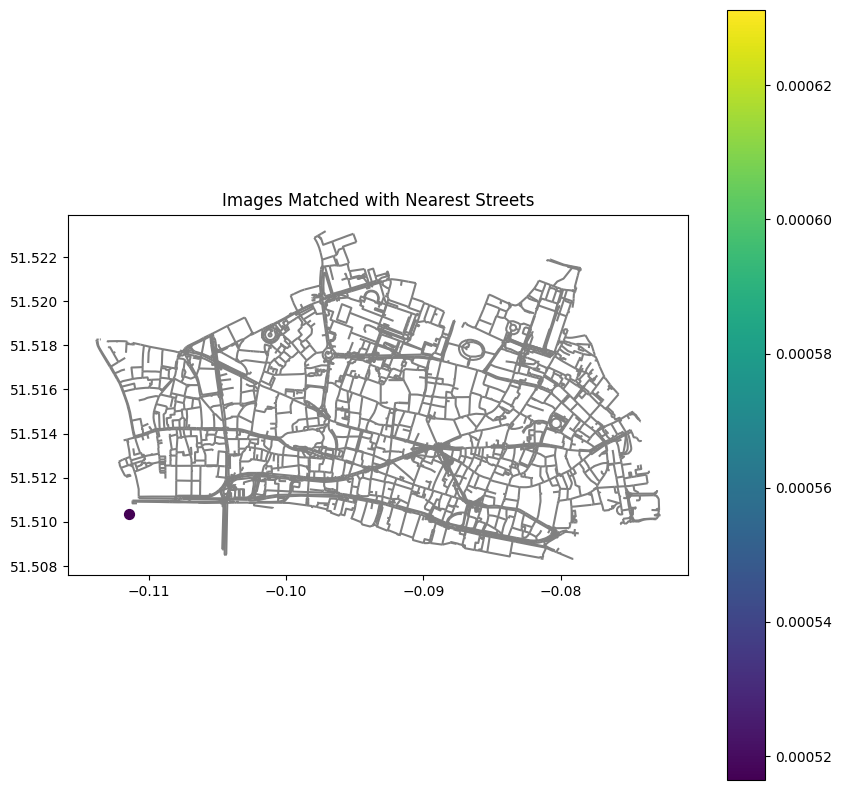

In [92]:
# Display Matched Results

# Print the matched results, including image IDs and distances to the nearest streets
print(matched[['image_id', 'distance']])

# Optionally, visualize the matched results on a map
import matplotlib.pyplot as plt

# Plot the streets
base = streets.plot(color='gray', figsize=(10, 10))

# Plot the images with distances
matched_first_row.plot(ax=base, column='distance', legend=True, cmap='viridis', markersize=50)

plt.title('Images Matched with Nearest Streets')
plt.show()

c:\Users\yigit\anaconda3\anaconda goeie\envs\street\Lib\site-packages\geopandas\array.py:403: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_nearest' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  warnings.warn(


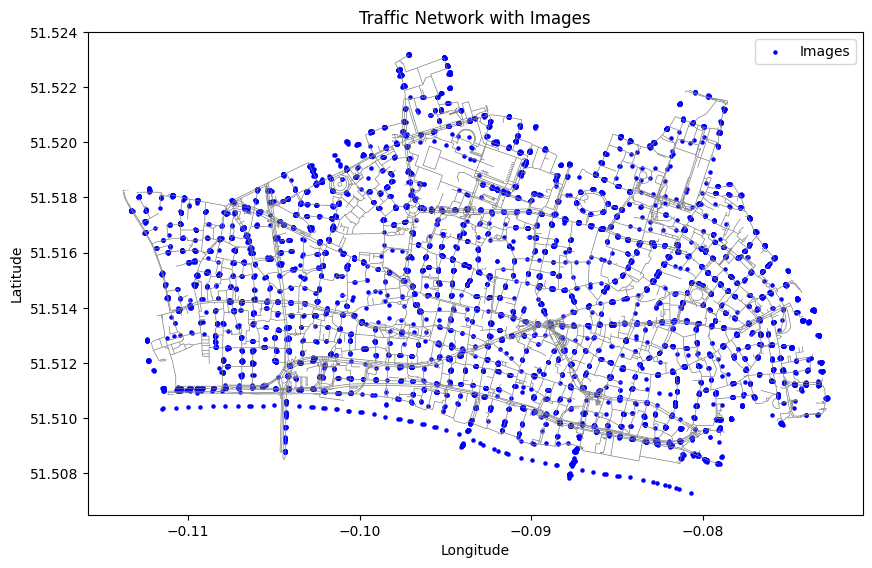

In [93]:
import geopandas as gpd
from shapely.geometry import Point
import pandas as pd
import matplotlib.pyplot as plt

# Load street network data
# streets = gpd.read_file('streets.geojson')  # Replace with your data source

# Assuming panoids DataFrame has columns 'panoid', 'lng', and 'lat'
# Example:
# panoids = pd.DataFrame({
#     'panoid': ['id1', 'id2', 'id3', ...],
#     'lng': [-0.10543, -0.0949, -0.10601, ...],
#     'lat': [51.51575, 51.51736, 51.51575, ...]
# })

# Create a DataFrame with image IDs and their corresponding GPS coordinates
image_data = {
    'image_id': np.arange(len(panoids)),
    'panoid': panoids.panoid,
    'longitude': panoids.lng,
    'latitude': panoids.lat,
}
images_df = pd.DataFrame(image_data)

# Create GeoDataFrame for images
geometry = [Point(xy) for xy in zip(images_df['longitude'], images_df['latitude'])]
images_gdf = gpd.GeoDataFrame(images_df, geometry=geometry, crs=streets.crs)

# Perform Spatial Join to find nearest street for each image
matched = gpd.sjoin_nearest(images_gdf, streets, how='left', distance_col='distance')
# Function to get coordinates by image ID
def get_coords_by_image_id(image_id):
    row = matched[matched['image_id'] == image_id]
    if not row.empty:
        return row['geometry'].values[0].x, row['geometry'].values[0].y
    else:
        return None, None

# Visualize the traffic network with images
fig, ax = plt.subplots(figsize=(10, 10))
streets.plot(ax=ax, color='gray', linewidth=0.5)
images_gdf.plot(ax=ax, color='blue', markersize=5, label='Images')

# Add labels and legend
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Traffic Network with Images')
plt.legend()

plt.show()

In [94]:
streets

,level_0,level_1,u,v,key,geometry
0,346,0,20626290,1590088441,0,"LINESTRING (-0.083659 51.509, -0.083712 51.508..."
1,345,0,20626290,2278320131,0,"LINESTRING (-0.085886 51.509, -0.08535 51.509)"
2,128,0,108838,2278320131,0,"LINESTRING (-0.085886 51.509, -0.086233 51.509..."
3,3288,0,2278320131,2278320167,0,"LINESTRING (-0.085609 51.509, -0.085773 51.509..."
4,344,0,20626290,10306429319,0,"LINESTRING (-0.085173 51.509, -0.08535 51.509)"
...,...,...,...,...,...,...
5473,3620,0,3197339674,3197339676,0,"LINESTRING (-0.080744 51.521, -0.080545 51.521)"
5474,1393,0,28728187,3197339676,0,"LINESTRING (-0.080744 51.521, -0.081099 51.521)"
5475,5028,0,6866779809,6866779814,0,"LINESTRING (-0.081004 51.522, -0.080984 51.522..."
5476,4177,0,4316306163,6711365597,0,"LINESTRING (-0.0808 51.522, -0.08076 51.522)"


In [95]:
# Re-project the streets GeoDataFrame to a projected CRS
# EPSG:27700 is the British National Grid, suitable for the UK
streets_projected = streets.to_crs(epsg=28992)

# Calculate the length of each street in the projected CRS
streets_length = streets_projected.length

# Add the lengths back to the original GeoDataFrame if needed
streets['length'] = streets_length


# Now you can use 'streets['length']' for further analysis

In [96]:
streets['length']

0       136.036146
1        38.105447
2        27.635476
3        77.548686
4        79.321042
           ...    
5473     14.905991
5474     26.387202
5475    113.653937
5476      3.009515
5477     94.399716
Name: length, Length: 5478, dtype: float64

Buffer function python


<Axes: >

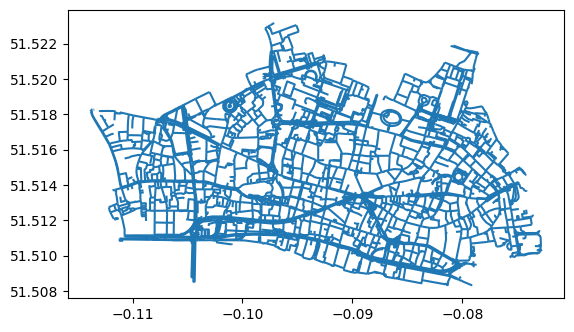

In [97]:
streets.plot()

In [98]:
import geopandas as gpd
from shapely.geometry import LineString

def split_line(line, max_segment_length=50):
    # Calculate the number of segments
    num_segments = int(line.length // max_segment_length) + 1
    segment_length = line.length / num_segments
    
    # Create a list to store the segments
    segments = []
    
    # Generate points along the line at each segment length
    for i in range(num_segments):
        start_point = line.interpolate(i * segment_length)
        end_point = line.interpolate(min((i + 1) * segment_length, line.length))
        segment = LineString([start_point, end_point])
        segments.append(segment)
    
    return segments

# Load the streets data
streets = gpd.read_file('London_UK/network/edges/edges.geojson')

# Re-project to a suitable CRS if necessary
if streets.crs.is_geographic:
    streets = streets.to_crs(epsg=28992)  # Use a projected CRS like EPSG:28992 for the Netherlands

# Calculate lengths
streets['length'] = streets.length

# Split lines longer than 100 meters
split_segments = []
for _, row in streets.iterrows():
    if row['length'] > 100:
        split_segments.extend(split_line(row['geometry'], max_segment_length=50))
    else:
        split_segments.append(row['geometry'])

# Create a new GeoDataFrame with the split segments
split_streets_gdf_max = gpd.GeoDataFrame(geometry=split_segments, crs=streets.crs)

# Optionally, calculate the new lengths
split_streets_gdf_max_L = split_streets_gdf.length

# Display the result
print(split_streets_gdf_max_L)

0       32.202141
1       45.345370
2       45.345382
3       38.105447
4       27.635476
          ...    
5807    33.118631
5808    37.884646
5809    37.805940
5810     3.009515
5811    94.399716
Length: 5812, dtype: float64


In [99]:
split_streets_gdf.explore()

In [100]:
import geopandas as gpd
from shapely.geometry import LineString
from shapely.ops import linemerge

def merge_short_lines(streets_gdf, min_total_length=50, max_individual_length=10):
    merged_segments = []
    current_merge = []

    for _, row in streets_gdf.iterrows():
        line = row['geometry']
        line_length = line.length

        if line_length < max_individual_length:
            current_merge.append(line)
            total_length = sum([seg.length for seg in current_merge])

            if total_length >= min_total_length:
                merged_line = linemerge(current_merge)
                merged_segments.append(merged_line)
                current_merge = []
        else:
            if current_merge:
                merged_line = linemerge(current_merge)
                merged_segments.append(merged_line)
                current_merge = []
            merged_segments.append(line)

    # If there are any remaining lines in the current merge, add them
    if current_merge:
        merged_line = linemerge(current_merge)
        merged_segments.append(merged_line)

    return gpd.GeoDataFrame(geometry=merged_segments, crs=streets_gdf.crs)



# Merge short lines
merged_streets_gdf = merge_short_lines(split_streets_gdf_max)

# Optionally, calculate the new lengths
merged_streets_gdf['length'] = merged_streets_gdf.length

merged_streets_gdf


,geometry,length
0,"LINESTRING (-2.25e+05 4.05e+05, -2.25e+05 4.05...",32.202141
1,"LINESTRING (-2.25e+05 4.05e+05, -2.25e+05 4.05...",45.345370
2,"LINESTRING (-2.25e+05 4.05e+05, -2.25e+05 4.05...",45.345382
3,"LINESTRING (-2.25e+05 4.05e+05, -2.25e+05 4.05...",38.105447
4,"LINESTRING (-2.25e+05 4.05e+05, -2.25e+05 4.05...",27.635476
...,...,...
5029,"LINESTRING (-2.24e+05 4.07e+05, -2.24e+05 4.07...",33.118631
5030,"LINESTRING (-2.24e+05 4.07e+05, -2.24e+05 4.07...",37.884646
5031,"LINESTRING (-2.24e+05 4.07e+05, -2.24e+05 4.07...",37.805940
5032,"LINESTRING (-2.24e+05 4.07e+05, -2.24e+05 4.07...",3.009515


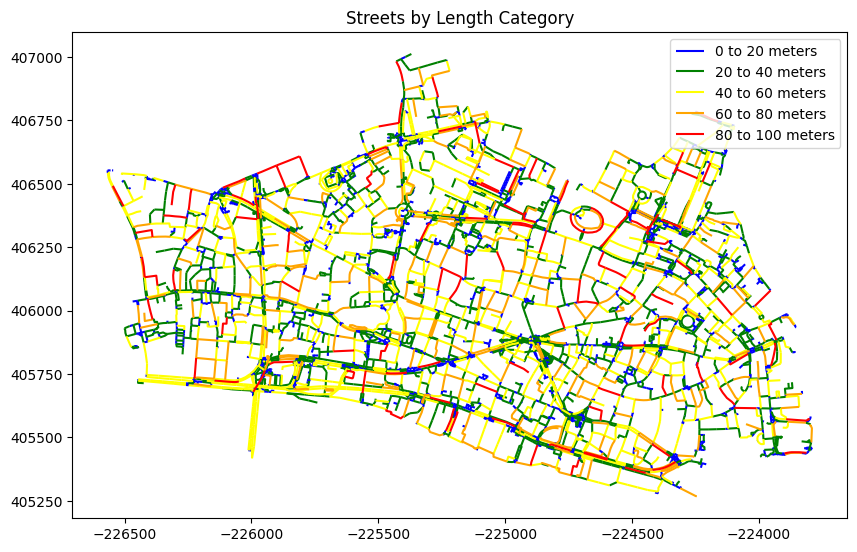

In [101]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np

# Define a function to categorize lengths and assign colors
def categorize_and_plot(gdf):
    # Define the bins and corresponding colors
    bins = [0, 20, 40, 60, 80, 100]
    colors = ['blue', 'green', 'yellow', 'orange', 'red']
    
    # Create a new column 'category' based on the length
    gdf['category'] = np.digitize(gdf['length'], bins, right=True)
    
    # Plot each category with a different color
    fig, ax = plt.subplots(figsize=(10, 10))
    for i, color in enumerate(colors, start=1):
        category_gdf = gdf[gdf['category'] == i]
        if not category_gdf.empty:
            category_gdf.plot(ax=ax, color=color, label=f'{bins[i-1]} to {bins[i]} meters')
    
    plt.title('Streets by Length Category')
    plt.legend()
    plt.show()

# Load the streets data
streets = gpd.read_file('London_UK/network/edges/edges.geojson')

# Re-project to a suitable CRS if necessary
if streets.crs.is_geographic:
    streets = streets.to_crs(epsg=28992)  # Use a projected CRS like EPSG:28992 for the Netherlands

# Calculate lengths
streets['length'] = streets.length

# Filter out lines longer than 100 meters
filtered_streets_gdf = streets[streets['length'] <= 100]

# Call the function to categorize and plot
categorize_and_plot(merged_streets_gdf)

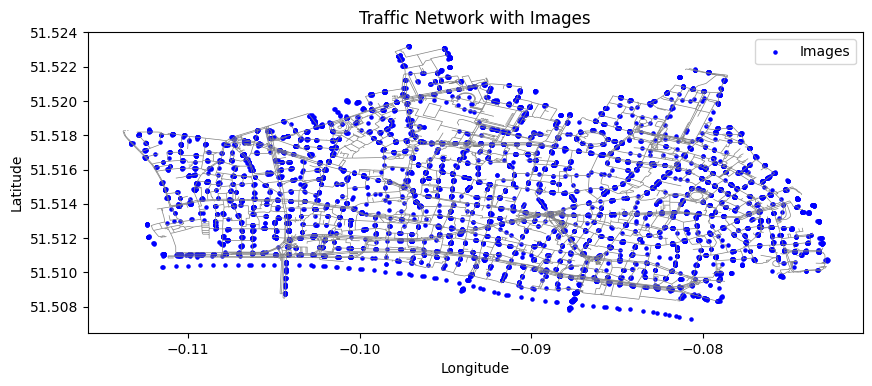

In [117]:
import geopandas as gpd
from shapely.geometry import Point
import pandas as pd
import matplotlib.pyplot as plt

# Load street network data
# streets = gpd.read_file('streets.geojson')  # Replace with your data source

# Assuming panoids DataFrame has columns 'panoid', 'lng', and 'lat'
# Example:
# panoids = pd.DataFrame({
#     'panoid': ['id1', 'id2', 'id3', ...],
#     'lng': [-0.10543, -0.0949, -0.10601, ...],
#     'lat': [51.51575, 51.51736, 51.51575, ...]
# })

# Create a DataFrame with image IDs and their corresponding GPS coordinates
image_data = {
    'image_id': np.arange(len(panoids)),
    'panoid': panoids.panoid,
    'longitude': panoids.lng,
    'latitude': panoids.lat,
}
images_df = pd.DataFrame(image_data)

# Create GeoDataFrame for images
geometry = [Point(xy) for xy in zip(images_df['longitude'], images_df['latitude'])]
images_gdf = gpd.GeoDataFrame(images_df, geometry=geometry, crs=merged_streets_gdf.crs)

# Perform Spatial Join to find nearest street for each image
matched = gpd.sjoin_nearest(images_gdf, merged_streets_gdf, how='left', distance_col='distance')
# Function to get coordinates by image ID
def get_coords_by_image_id(image_id):
    row = matched[matched['image_id'] == image_id]
    if not row.empty:
        return row['geometry'].values[0].x, row['geometry'].values[0].y
    else:
        return None, None

# Visualize the traffic network with images
fig, ax = plt.subplots(figsize=(10, 10))
streets.plot(ax=ax, color='gray', linewidth=0.5)
images_gdf.plot(ax=ax, color='blue', markersize=5, label='Images')

# Add labels and legend
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Traffic Network with Images')
plt.legend()

plt.show()

In [115]:
matched.explore()

In [105]:
streets = network

In [116]:
panoids.explore()


In [106]:
streets.head()

,level_0,level_1,u,v,key,geometry,length
0,346,0,20626290,1590088441,0,"LINESTRING (-0.083659 51.509, -0.083712 51.508...",136.036146
1,345,0,20626290,2278320131,0,"LINESTRING (-0.085886 51.509, -0.08535 51.509)",38.105447
2,128,0,108838,2278320131,0,"LINESTRING (-0.085886 51.509, -0.086233 51.509...",27.635476
3,3288,0,2278320131,2278320167,0,"LINESTRING (-0.085609 51.509, -0.085773 51.509...",77.548686
4,344,0,20626290,10306429319,0,"LINESTRING (-0.085173 51.509, -0.08535 51.509)",79.321042


In [107]:
import geopandas as gpd

# Load the streets data if not already loaded
streets = gpd.read_file('London_UK/network/edges/edges.geojson')

# Iterate over each pair of LineStrings to find intersections
for i, line1 in enumerate(streets['geometry']):
    for j, line2 in enumerate(streets['geometry']):
        if i >= j:  # Avoid duplicate checks and self-intersection
            continue
        if line1.intersects(line2):
            print(f"LineString at index {i} intersects with LineString at index {j}.")
            print(f"LineString {i}: {line1}")
            print(f"LineString {j}: {line2}")
            break  # Stop after finding the first intersection
    else:
        continue
    break

LineString at index 0 intersects with LineString at index 1.
LineString 0: LINESTRING (-0.08365880000000001 51.5086128, -0.08371190000000001 51.508434, -0.0846832 51.5085481, -0.08535 51.5086248)
LineString 1: LINESTRING (-0.0858862 51.5086966, -0.08535 51.5086248)


In [108]:
import geopandas as gpd
from shapely.geometry import Point

# Load the streets data if not already loaded
streets = gpd.read_file('London_UK/network/edges/edges.geojson')

# Iterate over each pair of LineStrings to find intersections
for i, line1 in enumerate(streets['geometry']):
    for j, line2 in enumerate(streets['geometry']):
        if i >= j:  # Avoid duplicate checks and self-intersection
            continue
        if line1.intersects(line2):
            intersection = line1.intersection(line2)
            if isinstance(intersection, Point):
                print(f"LineString at index {i} intersects with LineString at index {j}.")
                print(f"Intersection Point: {intersection}")
            elif intersection.geom_type == 'MultiPoint':
                print(f"LineString at index {i} intersects with LineString at index {j}.")
                print(f"Intersection Points: {list(intersection)}")
            break  # Stop after finding the first intersection
    else:
        continue
    break

LineString at index 0 intersects with LineString at index 1.
Intersection Point: POINT (-0.08535 51.5086248)


In [109]:
import geopandas as gpd
from shapely.geometry import Point, MultiPoint

# Load the streets data if not already loaded
streets = gpd.read_file('London_UK/network/edges/edges.geojson')

# Create a list to store intersection points
intersection_points = []

# Iterate over each pair of LineStrings to find intersections
for i, line1 in enumerate(streets['geometry']):
    for j, line2 in enumerate(streets['geometry']):
        if i >= j:  # Avoid duplicate checks and self-intersection
            continue
        if line1.intersects(line2):
            intersection = line1.intersection(line2)
            if intersection.geom_type == 'Point':
                intersection_points.append(intersection)
            elif intersection.geom_type == 'MultiPoint':
                intersection_points.extend(intersection)

# Create a GeoDataFrame for the intersection points
intersection_gdf = gpd.GeoDataFrame(geometry=intersection_points, crs=streets.crs)

# Display the intersection points
print(intersection_gdf)

# Optionally, plot the intersection points
intersection_gdf.plot(marker='o', color='red', markersize=5)

TypeError: 'MultiPoint' object is not iterable

In [111]:
import geopandas as gpd
from shapely.geometry import Point, MultiPoint

# Load the streets data if not already loaded
streets = gpd.read_file('London_UK/network/edges/edges.geojson')

# Create a list to store intersection points
intersection_points = []

# Iterate over each pair of LineStrings to find intersections
for i, line1 in enumerate(streets['geometry']):
    for j, line2 in enumerate(streets['geometry']):
        if i >= j:  # Avoid duplicate checks and self-intersection
            continue
        if line1.intersects(line2):
            intersection = line1.intersection(line2)
            if intersection.geom_type == 'Point':
                intersection_points.append(intersection)
            elif intersection.geom_type == 'MultiPoint':
                intersection_points.extend([pt for pt in intersection.geoms])

# Create a GeoDataFrame for the intersection points
intersection_gdf = gpd.GeoDataFrame(geometry=intersection_points, crs=streets.crs)

# Display the intersection points
print(intersection_gdf)

# Optionally, plot the intersection points
intersection_gdf.plot(marker='o', color='red', markersize=5)

KeyboardInterrupt: 